# Importing required libraries

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Creating dataframes

In [23]:
DATA_FOLDER = "C:\\Users\\hp\\OneDrive\\Desktop\\Uber\\Dataset\\"

In [24]:
apr14 = pd.read_csv(DATA_FOLDER+'uber-raw-data-apr14.csv')
may14 = pd.read_csv(DATA_FOLDER+'uber-raw-data-may14.csv')
jun14 = pd.read_csv(DATA_FOLDER+'uber-raw-data-jun14.csv')
jul14 = pd.read_csv(DATA_FOLDER+'uber-raw-data-jul14.csv')
aug14 = pd.read_csv(DATA_FOLDER+'uber-raw-data-aug14.csv')
sep14 = pd.read_csv(DATA_FOLDER+'uber-raw-data-sep14.csv')

# concatenate dataframes

In [25]:
merged_df = pd.concat([apr14, may14, jun14, jul14, aug14, sep14])
merged_df

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
...,...,...,...,...
1028131,9/30/2014 22:57:00,40.7668,-73.9845,B02764
1028132,9/30/2014 22:57:00,40.6911,-74.1773,B02764
1028133,9/30/2014 22:58:00,40.8519,-73.9319,B02764
1028134,9/30/2014 22:58:00,40.7081,-74.0066,B02764


# String to datetime conversion

In [26]:
apr14['Date/Time'] = pd.to_datetime(apr14['Date/Time'], format='%m/%d/%Y %H:%M:%S')
may14['Date/Time'] = pd.to_datetime(may14['Date/Time'], format='%m/%d/%Y %H:%M:%S')
jun14['Date/Time'] = pd.to_datetime(jun14['Date/Time'], format='%m/%d/%Y %H:%M:%S')
jul14['Date/Time'] = pd.to_datetime(jul14['Date/Time'], format='%m/%d/%Y %H:%M:%S')
aug14['Date/Time'] = pd.to_datetime(aug14['Date/Time'], format='%m/%d/%Y %H:%M:%S')
sep14['Date/Time'] = pd.to_datetime(sep14['Date/Time'], format='%m/%d/%Y %H:%M:%S')
merged_df['Date/Time'] = pd.to_datetime(merged_df['Date/Time'], format='%m/%d/%Y %H:%M:%S')

In [27]:
dfs = [apr14, may14, jun14, jul14, aug14, sep14, merged_df]
current_df = dfs[0]

# Rideshare histogram

In [28]:
current_df['Time'] = current_df['Date/Time'].dt.time.apply(lambda x: int(x.strftime('%H%M%S')))
current_df

,Date/Time,Lat,Lon,Base,Time
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1100
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1700
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,2100
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,2800
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,3300
...,...,...,...,...,...
564511,2014-04-30 23:22:00,40.7640,-73.9744,B02764,232200
564512,2014-04-30 23:26:00,40.7629,-73.9672,B02764,232600
564513,2014-04-30 23:31:00,40.7443,-73.9889,B02764,233100
564514,2014-04-30 23:32:00,40.6756,-73.9405,B02764,233200


<AxesSubplot:xlabel='Time', ylabel='Count'>

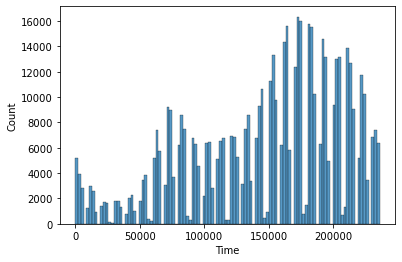

In [29]:
sns.histplot(current_df['Time'])


# Filtering morning and evening rides

In [30]:
morning_df_idx = (current_df['Time'] > 50000) & (current_df['Time'] < 110000)
morning_df = current_df[morning_df_idx]
evening_df_idx = (current_df['Time'] > 150000) & (current_df['Time'] < 220000)
evening_df = current_df[evening_df_idx]

In [31]:
morning_df

,Date/Time,Lat,Lon,Base,Time
30,2014-04-01 05:08:00,40.7141,-74.0094,B02512,50800
31,2014-04-01 05:12:00,40.7893,-73.9709,B02512,51200
32,2014-04-01 05:18:00,40.7747,-73.9910,B02512,51800
33,2014-04-01 05:19:00,40.7689,-73.9876,B02512,51900
34,2014-04-01 05:23:00,40.7744,-74.0149,B02512,52300
...,...,...,...,...,...
564028,2014-04-30 10:55:00,40.7665,-73.9514,B02764,105500
564029,2014-04-30 10:55:00,40.7266,-73.9076,B02764,105500
564030,2014-04-30 10:56:00,40.7365,-73.9816,B02764,105600
564031,2014-04-30 10:57:00,40.7710,-73.8659,B02764,105700


In [32]:
evening_df

,Date/Time,Lat,Lon,Base,Time
498,2014-04-01 15:02:00,40.7284,-74.0071,B02512,150200
499,2014-04-01 15:03:00,40.7079,-74.0093,B02512,150300
500,2014-04-01 15:04:00,40.7692,-73.9631,B02512,150400
501,2014-04-01 15:07:00,40.7644,-73.9530,B02512,150700
502,2014-04-01 15:08:00,40.7553,-73.9795,B02512,150800
...,...,...,...,...,...
564477,2014-04-30 21:55:00,40.7528,-73.9853,B02764,215500
564478,2014-04-30 21:55:00,40.7251,-74.0024,B02764,215500
564479,2014-04-30 21:58:00,40.7526,-73.9949,B02764,215800
564480,2014-04-30 21:58:00,40.7405,-74.0059,B02764,215800


In [39]:
morning_coordinates = morning_df[['Lat','Lon']].sample(10000,random_state = 10).values
evening_coordinates = evening_df[['Lat','Lon']].sample(10000,random_state = 10).values
type(morning_coordinates)
morning_coordinates

array([[ 40.7226, -74.0046],
       [ 40.7488, -74.0046],
       [ 40.7879, -73.9712],
       ...,
       [ 40.6911, -73.9606],
       [ 40.6449, -73.7823],
       [ 40.7607, -73.996 ]])

# Installing folium
for plotting coordinates

In [34]:
 !pip install folium

In [35]:
import folium

# Plotting morning rides on map

In [49]:
morning_map = folium.Map(location=[40.79658011772687, -73.87341741832425], zoom_start = 12, tiles='Stamen Toner')
for coordinate in morning_coordinates:
    folium.CircleMarker(radius=1,location=list(coordinate),fill=True).add_to(morning_map)
morning_map

# Plotting evening rides on map

In [50]:
evening_map = folium.Map(location=[40.79658011772687, -73.87341741832425], zoom_start = 12, tiles='Stamen Toner')
for coordinate in evening_coordinates:
  folium.CircleMarker(radius=1,location=list(coordinate),color="#FF0000",fill=True).add_to(evening_map)
evening_map

# Importing KMeans

In [51]:
from sklearn.cluster import KMeans
import numpy as np

# Finding clusters

In [52]:
n_clusters = 6
model = KMeans(n_clusters=n_clusters, init='random', max_iter=300)
model.fit(morning_df[['Lat','Lon']])

KMeans(init='random', n_clusters=6)

In [53]:
morning_centroids = model.cluster_centers_
print(morning_centroids)

[[ 40.73304907 -73.99558037]
 [ 40.68791486 -73.96540619]
 [ 40.66307319 -73.77356222]
 [ 40.77350344 -73.96731519]
 [ 40.79309185 -73.86484158]
 [ 40.69828782 -74.20574989]]


In [55]:
for i, coordinate in enumerate(morning_centroids):
    folium.Marker(list(coordinate), popup='Centroid {}'.format(i+1), icon=folium.Icon(color='red')).add_to(morning_map)
morning_map

## for evening

In [56]:
n_clusters = 6
model = KMeans(n_clusters=n_clusters, init='random', max_iter=300)
model.fit(evening_df[['Lat','Lon']])

KMeans(init='random', n_clusters=6)

In [57]:
evening_centroids = model.cluster_centers_
evening_centroids

array([[ 40.6573588 , -73.77433277],
       [ 40.73068913, -73.99943728],
       [ 40.79472761, -73.87001515],
       [ 40.69961741, -74.20066416],
       [ 40.68838102, -73.9681331 ],
       [ 40.76285404, -73.97460107]])

In [58]:
for i, coordinate in enumerate(evening_centroids):
    folium.Marker(list(coordinate), popup='Centroid {}'.format(i+1), icon=folium.Icon(color='blue')).add_to(evening_map)
evening_map

# Finding clusters in whole selected dataframe

In [59]:
n_clusters = 8
model = KMeans(n_clusters=n_clusters, init='random', max_iter=300)
model.fit(current_df[['Lat','Lon']])

KMeans(init='random')

In [60]:
centroids = model.cluster_centers_
centroids

array([[ 40.78130454, -73.87022093],
       [ 40.78209302, -73.95890153],
       [ 40.97222233, -73.61633838],
       [ 40.68794189, -73.96472411],
       [ 40.75581977, -73.98133588],
       [ 40.70056661, -74.20165533],
       [ 40.65584848, -73.77949983],
       [ 40.72767047, -74.00034757]])

In [61]:
map = folium.Map(location=[40.79658011772687, -73.87341741832425], zoom_start = 12, tiles='Stamen Toner')
for i, coordinate in enumerate(centroids):
    folium.Marker(list(coordinate), popup='Centroid {}'.format(i+1), icon=folium.Icon(color='blue')).add_to(map)
map

In [62]:
new_ride = (40.70647056912189, -73.91116590442799)
folium.Marker(new_ride, popup='New Rider', icon=folium.Icon(color='green')).add_to(map)
map

In [63]:
centroid_idx = model.predict([new_ride])

In [64]:
centroids[centroid_idx]

array([[ 40.68794189, -73.96472411]])

In [66]:
folium.Marker(list(centroids[centroid_idx][0]), icon=folium.Icon(color='yellow')).add_to(map)
map

<ipython-input-66-60730c77e7c8>:1: UserWarning: color argument of Icon should be one of: {'darkred', 'darkpurple', 'orange', 'lightblue', 'lightgray', 'black', 'pink', 'gray', 'blue', 'beige', 'green', 'darkblue', 'darkgreen', 'lightgreen', 'purple', 'cadetblue', 'lightred', 'white', 'red'}.
  folium.Marker(list(centroids[centroid_idx][0]), icon=folium.Icon(color='yellow')).add_to(map)


In [ ]:
#Drive link : http://bit.ly/TLUberCode
#Notebook link: http://bit.ly/TLUberNotebook
#Feedback link: https://docs.google.com/forms/d/1BQH6adewKR9NhYIwV4mdSvKzfKP2xaVElyGuSmP7opY/edit